#### Monday, January 8, 2024

[Inpainting](https://huggingface.co/docs/diffusers/using-diffusers/inpaint)

Manually generated from the above document page. And again, there is a Colab link, but it is not this entire document.

docker container start hfpt_Dec14

This all runs with the exception of cell 30 in the 'Prompt Weighting' section which wants to reference 2 prompt objects which were never created ... after that cell, just continue with the remainder of the notebook.

## Inpainting

Inpainting replaces or edits specific areas of an image. This makes it a useful tool for image restoration like removing defects and artifacts, or even replacing an image area with something entirely new. Inpainting relies on a mask to determine which regions of an image to fill in; the area to inpaint is represented by white pixels and the area to keep is represented by black pixels. The white pixels are filled in by the prompt.

With 🤗 Diffusers, here is how you can do inpainting:

1) Load an inpainting checkpoint with the [AutoPipelineForInpainting](https://huggingface.co/docs/diffusers/v0.25.0/en/api/pipelines/auto_pipeline#diffusers.AutoPipelineForInpainting) class. This’ll automatically detect the appropriate pipeline class to load based on the checkpoint:


In [1]:
import torch
from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

pipeline = AutoPipelineForInpainting.from_pretrained(
    "kandinsky-community/kandinsky-2-2-decoder-inpaint", torch_dtype=torch.float16
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

# 76m 51.3s

Loading pipeline components...:   0%|          | 0/3 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

In [2]:
!ls /root/.cache/huggingface/hub

models--CompVis--stable-diffusion-v1-4
models--TheBloke--CodeLlama-34B-Instruct-GPTQ
models--TheBloke--Llama-2-13b-Chat-GPTQ
models--anton-l--ddpm-butterflies-128
models--diffusers--stable-diffusion-xl-1.0-inpainting-0.1
models--google--ddpm-cat-256
models--google--ddpm-celebahq-256
models--google--ddpm-church-256
models--kandinsky-community--kandinsky-2-2-decoder
models--kandinsky-community--kandinsky-2-2-decoder-inpaint
models--kandinsky-community--kandinsky-2-2-prior
models--kohbanye--pixel-art-style
models--lllyasviel--control_v11p_sd15_inpaint
models--lllyasviel--control_v11p_sd15_openpose
models--microsoft--Orca-2-13b
models--microsoft--phi-2
models--mistralai--Mistral-7B-Instruct-v0.2
models--nitrosocke--Ghibli-Diffusion
models--nitrosocke--elden-ring-diffusion
models--ogkalu--Comic-Diffusion
models--runwayml--stable-diffusion-inpainting
models--runwayml--stable-diffusion-v1-5
models--stabilityai--sd-vae-ft-mse
models--stabilityai--sd-x2-latent-upscaler
models--stabilityai--stab

In [3]:
# docker cp c8324b70601d:///root/.cache/huggingface/hub/models--kandinsky-community--kandinsky-2-2-decoder-inpaint /home/rob/Data3/huggingface/transformers
# Successfully copied 5.28GB to /home/rob/Data3/huggingface/transformers

2) Load the base and mask images:

In [4]:
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint_mask.png")

3) Create a prompt to inpaint the image with and pass it to the pipeline with the base and mask images:

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

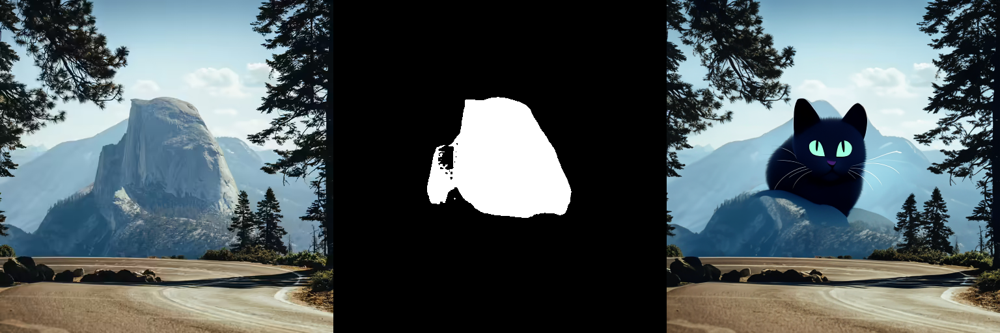

In [5]:
prompt = "a black cat with glowing eyes, cute, adorable, disney, pixar, highly detailed, 8k"
negative_prompt = "bad anatomy, deformed, ugly, disfigured"
image = pipeline(prompt=prompt, negative_prompt=negative_prompt, image=init_image, mask_image=mask_image).images[0]
make_image_grid([init_image, mask_image, image], rows=1, cols=3)

#### Create a mask image

Throughout this guide, the mask image is provided in all of the code examples for convenience. You can inpaint on your own images, but you’ll need to create a mask image for it. Use the Space below to easily create a mask image.

Upload a base image to inpaint on and use the sketch tool to draw a mask. Once you’re done, click Run to generate and download the mask image.

## Popular models

Stable Diffusion Inpainting, Stable Diffusion XL (SDXL) Inpainting, and Kandinsky 2.2 Inpainting are among the most popular models for inpainting. SDXL typically produces higher resolution images than Stable Diffusion v1.5, and Kandinsky 2.2 is also capable of generating high-quality images.


#### Stable Diffusion Inpainting

Stable Diffusion Inpainting is a latent diffusion model finetuned on 512x512 images on inpainting. It is a good starting point because it is relatively fast and generates good quality images. To use this model for inpainting, you’ll need to pass a prompt, base and mask image to the pipeline:

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

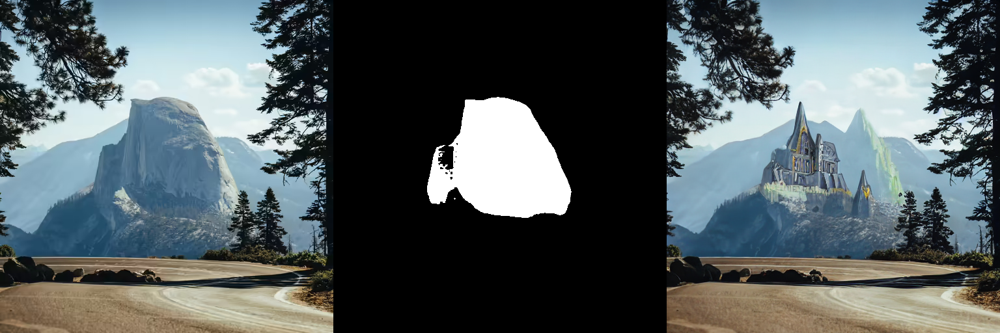

In [6]:
import torch
from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

pipeline = AutoPipelineForInpainting.from_pretrained(
    "runwayml/stable-diffusion-inpainting", torch_dtype=torch.float16, variant="fp16"
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

# load base and mask image
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint_mask.png")

generator = torch.Generator("cuda").manual_seed(92)
prompt = "concept art digital painting of an elven castle, inspired by lord of the rings, highly detailed, 8k"
image = pipeline(prompt=prompt, image=init_image, mask_image=mask_image, generator=generator).images[0]
make_image_grid([init_image, mask_image, image], rows=1, cols=3)

# 37m 36.6s

In [7]:
!ls /root/.cache/huggingface/hub

models--CompVis--stable-diffusion-v1-4
models--TheBloke--CodeLlama-34B-Instruct-GPTQ
models--TheBloke--Llama-2-13b-Chat-GPTQ
models--anton-l--ddpm-butterflies-128
models--diffusers--stable-diffusion-xl-1.0-inpainting-0.1
models--google--ddpm-cat-256
models--google--ddpm-celebahq-256
models--google--ddpm-church-256
models--kandinsky-community--kandinsky-2-2-decoder
models--kandinsky-community--kandinsky-2-2-decoder-inpaint
models--kandinsky-community--kandinsky-2-2-prior
models--kohbanye--pixel-art-style
models--lllyasviel--control_v11p_sd15_inpaint
models--lllyasviel--control_v11p_sd15_openpose
models--microsoft--Orca-2-13b
models--microsoft--phi-2
models--mistralai--Mistral-7B-Instruct-v0.2
models--nitrosocke--Ghibli-Diffusion
models--nitrosocke--elden-ring-diffusion
models--ogkalu--Comic-Diffusion
models--runwayml--stable-diffusion-inpainting
models--runwayml--stable-diffusion-v1-5
models--stabilityai--sd-vae-ft-mse
models--stabilityai--sd-x2-latent-upscaler
models--stabilityai--stab

In [8]:
# docker cp c8324b70601d:///root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting /home/rob/Data3/huggingface/transformers
# Successfully copied 2.74GB to /home/rob/Data3/huggingface/transformers

#### Stable Diffusion XL (SDXL) Inpainting

SDXL is a larger and more powerful version of Stable Diffusion v1.5. This model can follow a two-stage model process (though each model can also be used alone); the base model generates an image, and a refiner model takes that image and further enhances its details and quality. Take a look at the SDXL guide for a more comprehensive guide on how to use SDXL and configure it’s parameters.

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

The config attributes {'decay': 0.9999, 'inv_gamma': 1.0, 'min_decay': 0.0, 'optimization_step': 37000, 'power': 0.6666666666666666, 'update_after_step': 0, 'use_ema_warmup': False} were passed to UNet2DConditionModel, but are not expected and will be ignored. Please verify your config.json configuration file.


  0%|          | 0/49 [00:00<?, ?it/s]

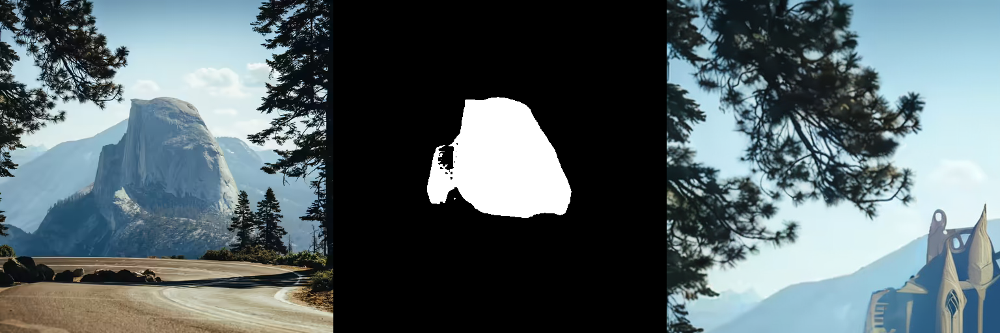

In [9]:
import torch
from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

pipeline = AutoPipelineForInpainting.from_pretrained(
    "diffusers/stable-diffusion-xl-1.0-inpainting-0.1", torch_dtype=torch.float16, variant="fp16"
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

# load base and mask image
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint_mask.png")

generator = torch.Generator("cuda").manual_seed(92)
prompt = "concept art digital painting of an elven castle, inspired by lord of the rings, highly detailed, 8k"
image = pipeline(prompt=prompt, image=init_image, mask_image=mask_image, generator=generator).images[0]
make_image_grid([init_image, mask_image, image], rows=1, cols=3)

# 101m 43.6s

In [10]:
!ls /root/.cache/huggingface/hub

models--CompVis--stable-diffusion-v1-4
models--TheBloke--CodeLlama-34B-Instruct-GPTQ
models--TheBloke--Llama-2-13b-Chat-GPTQ
models--anton-l--ddpm-butterflies-128
models--diffusers--stable-diffusion-xl-1.0-inpainting-0.1
models--google--ddpm-cat-256
models--google--ddpm-celebahq-256
models--google--ddpm-church-256
models--kandinsky-community--kandinsky-2-2-decoder
models--kandinsky-community--kandinsky-2-2-decoder-inpaint
models--kandinsky-community--kandinsky-2-2-prior
models--kohbanye--pixel-art-style
models--lllyasviel--control_v11p_sd15_inpaint
models--lllyasviel--control_v11p_sd15_openpose
models--microsoft--Orca-2-13b
models--microsoft--phi-2
models--mistralai--Mistral-7B-Instruct-v0.2
models--nitrosocke--Ghibli-Diffusion
models--nitrosocke--elden-ring-diffusion
models--ogkalu--Comic-Diffusion
models--runwayml--stable-diffusion-inpainting
models--runwayml--stable-diffusion-v1-5
models--stabilityai--sd-vae-ft-mse
models--stabilityai--sd-x2-latent-upscaler
models--stabilityai--stab

In [11]:
# docker cp c8324b70601d:///root/.cache/huggingface/hub/models--diffusers--stable-diffusion-xl-1.0-inpainting-0.1 /home/rob/Data3/huggingface/transformers
# Successfully copied 6.944GB to /home/rob/Data3/huggingface/transformers

#### Kandinsky 2.2 painting

The Kandinsky model family is similar to SDXL because it uses two models as well; the image prior model creates image embeddings, and the diffusion model generates images from them. You can load the image prior and diffusion model separately, but the easiest way to use Kandinsky 2.2 is to load it into the AutoPipelineForInpainting class which uses the KandinskyV22InpaintCombinedPipeline under the hood.

Loading pipeline components...:   0%|          | 0/3 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

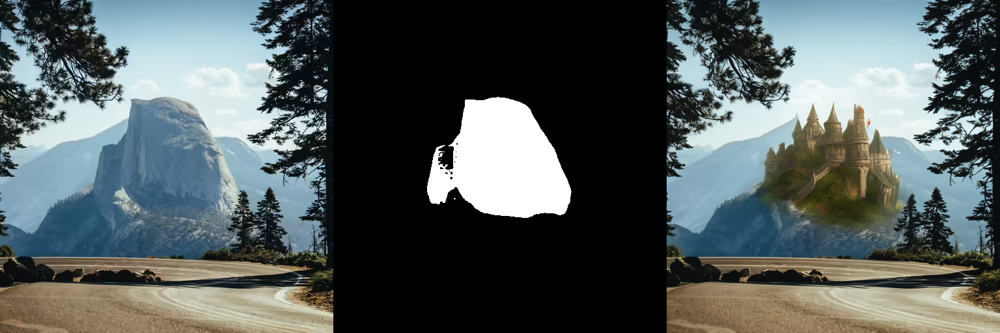

In [12]:
import torch
from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

pipeline = AutoPipelineForInpainting.from_pretrained(
    "kandinsky-community/kandinsky-2-2-decoder-inpaint", torch_dtype=torch.float16
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

# load base and mask image
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint_mask.png")

generator = torch.Generator("cuda").manual_seed(92)
prompt = "concept art digital painting of an elven castle, inspired by lord of the rings, highly detailed, 8k"
image = pipeline(prompt=prompt, image=init_image, mask_image=mask_image, generator=generator).images[0]
make_image_grid([init_image, mask_image, image], rows=1, cols=3)

# 35.5s

In [13]:
!ls /root/.cache/huggingface/hub

models--CompVis--stable-diffusion-v1-4
models--TheBloke--CodeLlama-34B-Instruct-GPTQ
models--TheBloke--Llama-2-13b-Chat-GPTQ
models--anton-l--ddpm-butterflies-128
models--diffusers--stable-diffusion-xl-1.0-inpainting-0.1
models--google--ddpm-cat-256
models--google--ddpm-celebahq-256
models--google--ddpm-church-256
models--kandinsky-community--kandinsky-2-2-decoder
models--kandinsky-community--kandinsky-2-2-decoder-inpaint
models--kandinsky-community--kandinsky-2-2-prior
models--kohbanye--pixel-art-style
models--lllyasviel--control_v11p_sd15_inpaint
models--lllyasviel--control_v11p_sd15_openpose
models--microsoft--Orca-2-13b
models--microsoft--phi-2
models--mistralai--Mistral-7B-Instruct-v0.2
models--nitrosocke--Ghibli-Diffusion
models--nitrosocke--elden-ring-diffusion
models--ogkalu--Comic-Diffusion
models--runwayml--stable-diffusion-inpainting
models--runwayml--stable-diffusion-v1-5
models--stabilityai--sd-vae-ft-mse
models--stabilityai--sd-x2-latent-upscaler
models--stabilityai--stab

#### Non-inpaint specific checkpoints

So far, this guide has used inpaint specific checkpoints such as runwayml/stable-diffusion-inpainting. But you can also use regular checkpoints like runwayml/stable-diffusion-v1-5. Let’s compare the results of the two checkpoints.

The image on the left is generated from a regular checkpoint, and the image on the right is from an inpaint checkpoint. You’ll immediately notice the image on the left is not as clean, and you can still see the outline of the area the model is supposed to inpaint. The image on the right is much cleaner and the inpainted area appears more natural.

<hfoptions id="regular-specific"> <hfoption id="runwayml/stable-diffusion-v1-5">

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

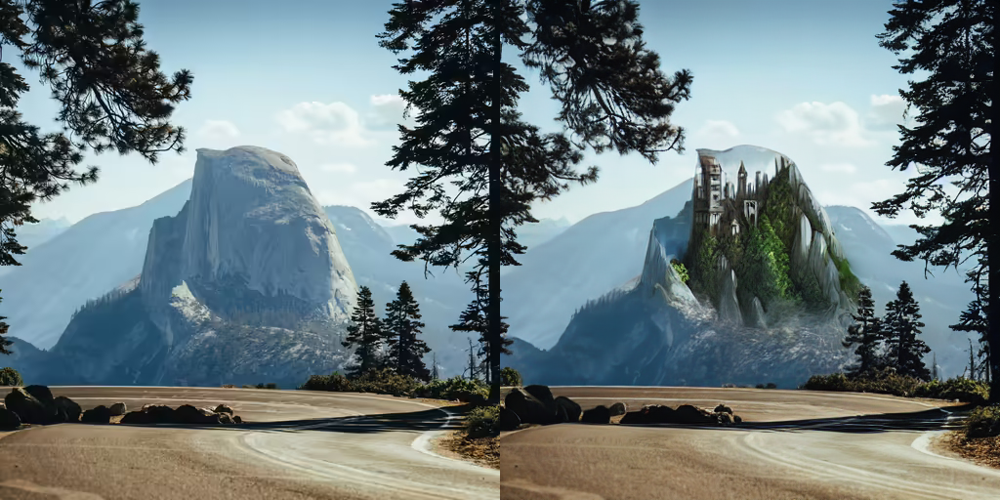

In [14]:
import torch
from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

pipeline = AutoPipelineForInpainting.from_pretrained(
    "runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16"
).to("cuda")
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

# load base and mask image
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint_mask.png")

generator = torch.Generator("cuda").manual_seed(92)
prompt = "concept art digital painting of an elven castle, inspired by lord of the rings, highly detailed, 8k"
image = pipeline(prompt=prompt, image=init_image, mask_image=mask_image, generator=generator).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

# 9.8s

</hfoption> <hfoption id="runwayml/stable-diffusion-inpainting">


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

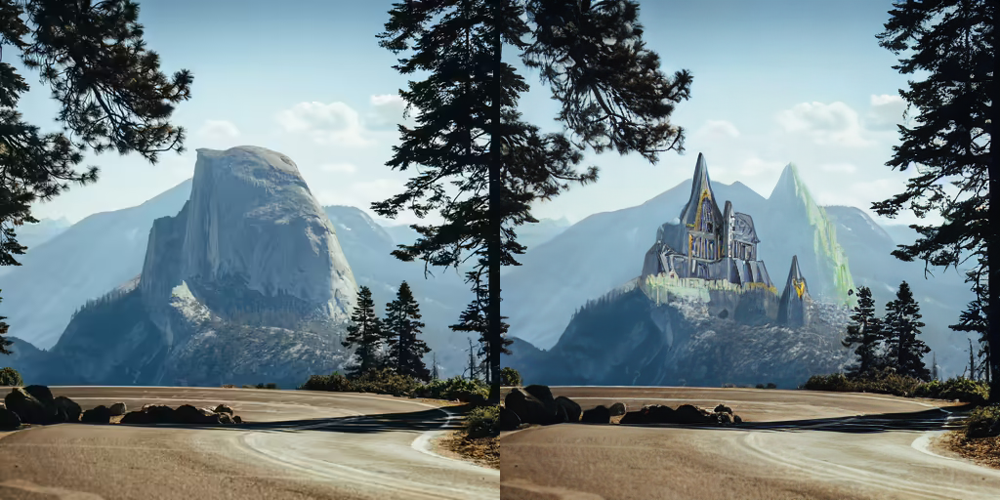

In [15]:
import torch
from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

pipeline = AutoPipelineForInpainting.from_pretrained(
    "runwayml/stable-diffusion-inpainting", torch_dtype=torch.float16, variant="fp16"
).to("cuda")
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

# load base and mask image
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint_mask.png")

generator = torch.Generator("cuda").manual_seed(92)
prompt = "concept art digital painting of an elven castle, inspired by lord of the rings, highly detailed, 8k"
image = pipeline(prompt=prompt, image=init_image, mask_image=mask_image, generator=generator).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

However, for more basic tasks like erasing an object from an image (like the rocks in the road for example), a regular checkpoint yields pretty good results. There isn’t as noticeable of difference between the regular and inpaint checkpoint.

<hfoptions id="inpaint"> <hfoption id="runwayml/stable-diffusion-v1-5">

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

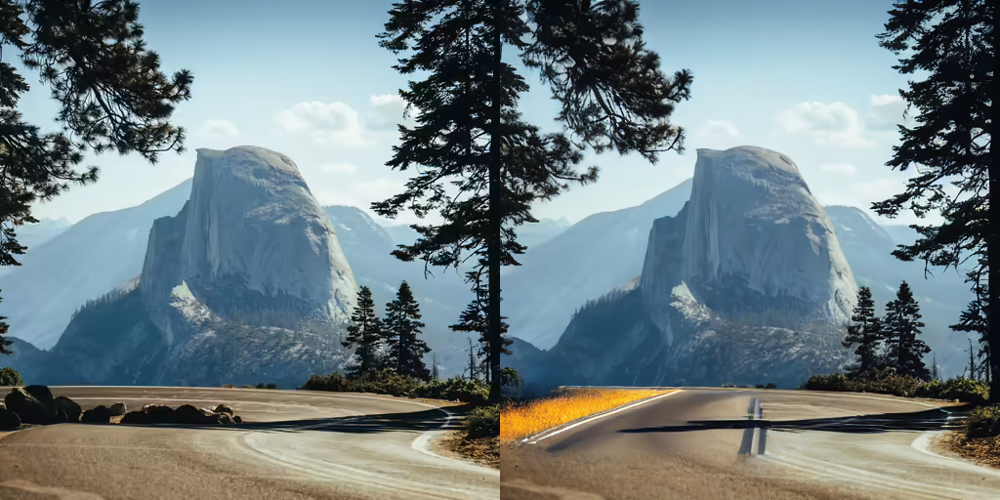

In [16]:
import torch
from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

pipeline = AutoPipelineForInpainting.from_pretrained(
    "runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16"
).to("cuda")
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

# load base and mask image
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/road-mask.png")

image = pipeline(prompt="road", image=init_image, mask_image=mask_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

</hfoption> <hfoption id="runwayml/stable-diffusion-inpaint">

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

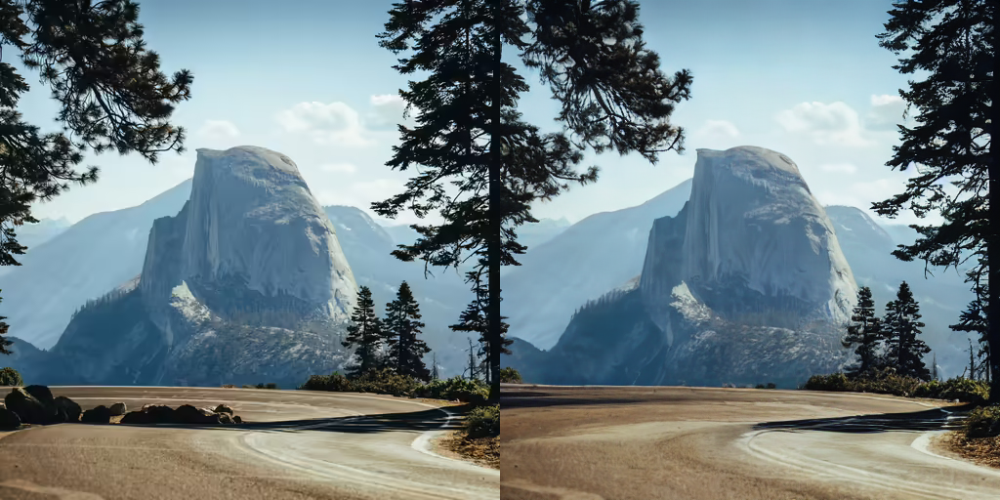

In [17]:
import torch
from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

pipeline = AutoPipelineForInpainting.from_pretrained(
    "runwayml/stable-diffusion-inpainting", torch_dtype=torch.float16, variant="fp16"
).to("cuda")
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

# load base and mask image
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/road-mask.png")

image = pipeline(prompt="road", image=init_image, mask_image=mask_image).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

</hfoption> </hfoptions>

The trade-off of using a non-inpaint specific checkpoint is the overall image quality may be lower, but it generally tends to preserve the mask area (that is why you can see the mask outline). The inpaint specific checkpoints are intentionally trained to generate higher quality inpainted images, and that includes creating a more natural transition between the masked and unmasked areas. As a result, these checkpoints are more likely to change your unmasked area.

If preserving the unmasked area is important for your task, you can use the code below to force the unmasked area of an image to remain the same at the expense of some more unnatural transitions between the masked and unmasked areas.

text_encoder/model.safetensors not found


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

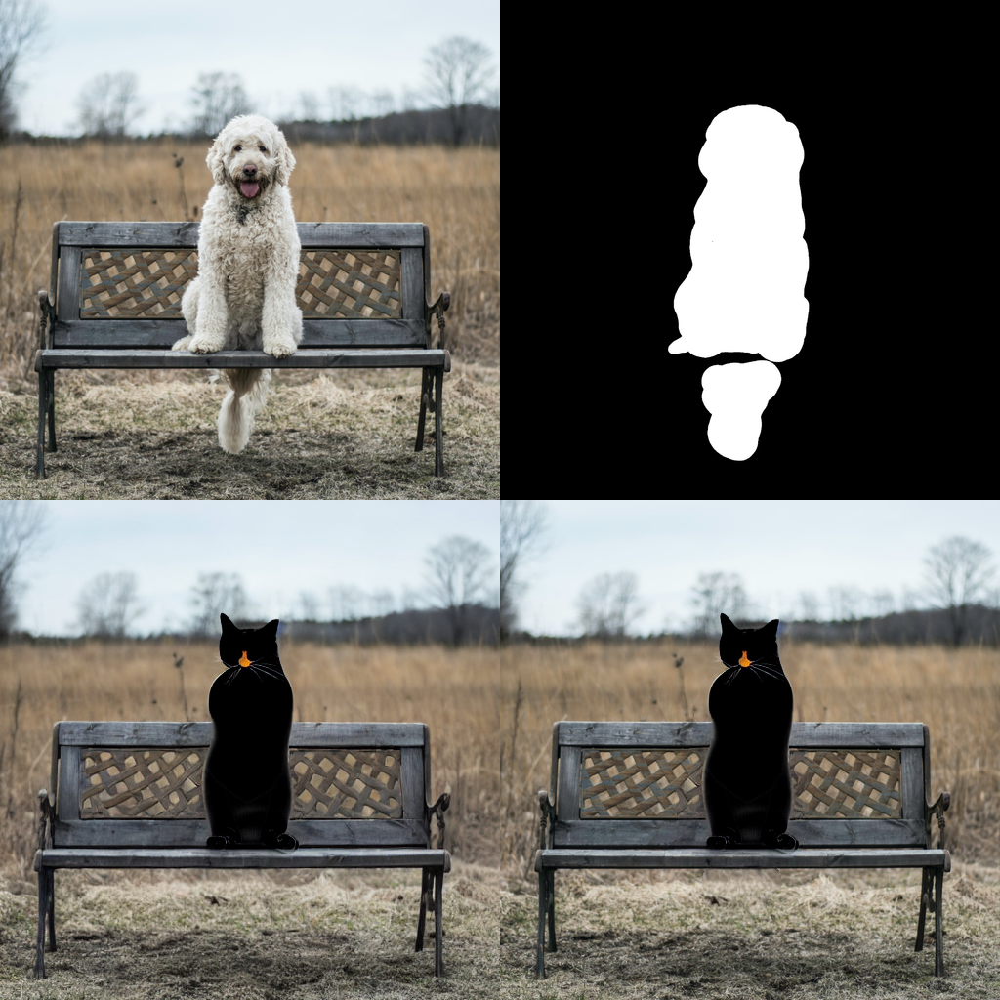

In [18]:
# Why did this cell download the model again? ... I can already see the model! ... WTF?

import PIL
import numpy as np
import torch

from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

device = "cuda"
pipeline = AutoPipelineForInpainting.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16,
)
pipeline = pipeline.to(device)

img_url = "https://raw.githubusercontent.com/CompVis/latent-diffusion/main/data/inpainting_examples/overture-creations-5sI6fQgYIuo.png"
mask_url = "https://raw.githubusercontent.com/CompVis/latent-diffusion/main/data/inpainting_examples/overture-creations-5sI6fQgYIuo_mask.png"

init_image = load_image(img_url).resize((512, 512))
mask_image = load_image(mask_url).resize((512, 512))

prompt = "Face of a yellow cat, high resolution, sitting on a park bench"
repainted_image = pipeline(prompt=prompt, image=init_image, mask_image=mask_image).images[0]
repainted_image.save("repainted_image.png")

# Convert mask to grayscale NumPy array
mask_image_arr = np.array(mask_image.convert("L"))
# Add a channel dimension to the end of the grayscale mask
mask_image_arr = mask_image_arr[:, :, None]
# Binarize the mask: 1s correspond to the pixels which are repainted
mask_image_arr = mask_image_arr.astype(np.float32) / 255.0
mask_image_arr[mask_image_arr < 0.5] = 0
mask_image_arr[mask_image_arr >= 0.5] = 1

# Take the masked pixels from the repainted image and the unmasked pixels from the initial image
unmasked_unchanged_image_arr = (1 - mask_image_arr) * init_image + mask_image_arr * repainted_image
unmasked_unchanged_image = PIL.Image.fromarray(unmasked_unchanged_image_arr.round().astype("uint8"))
unmasked_unchanged_image.save("force_unmasked_unchanged.png")
make_image_grid([init_image, mask_image, repainted_image, unmasked_unchanged_image], rows=2, cols=2)

# 81m, 54.6s

In [19]:
!ls /root/.cache/huggingface/hub

models--CompVis--stable-diffusion-v1-4
models--TheBloke--CodeLlama-34B-Instruct-GPTQ
models--TheBloke--Llama-2-13b-Chat-GPTQ
models--anton-l--ddpm-butterflies-128
models--diffusers--stable-diffusion-xl-1.0-inpainting-0.1
models--google--ddpm-cat-256
models--google--ddpm-celebahq-256
models--google--ddpm-church-256
models--kandinsky-community--kandinsky-2-2-decoder
models--kandinsky-community--kandinsky-2-2-decoder-inpaint
models--kandinsky-community--kandinsky-2-2-prior
models--kohbanye--pixel-art-style
models--lllyasviel--control_v11p_sd15_inpaint
models--lllyasviel--control_v11p_sd15_openpose
models--microsoft--Orca-2-13b
models--microsoft--phi-2
models--mistralai--Mistral-7B-Instruct-v0.2
models--nitrosocke--Ghibli-Diffusion
models--nitrosocke--elden-ring-diffusion
models--ogkalu--Comic-Diffusion
models--runwayml--stable-diffusion-inpainting
models--runwayml--stable-diffusion-v1-5
models--stabilityai--sd-vae-ft-mse
models--stabilityai--sd-x2-latent-upscaler
models--stabilityai--stab

In [20]:
# This target folder begain with 2.7gb of stuff ... so yeah, the model folder was already here, but stuff was missing ... I guess ..?

# docker cp c8324b70601d:///root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting /home/rob/Data3/huggingface/transformers
# Successfully copied 8.22GB to /home/rob/Data3/huggingface/transformers

#### Configure pipeline parameters

Image features - like quality and “creativity” - are dependent on pipeline parameters. Knowing what these parameters do is important for getting the results you want. Let’s take a look at the most important parameters and see how changing them affects the output.

#### Strength

strength is a measure of how much noise is added to the base image, which influences how similar the output is to the base image.

* 📈 a high strength value means more noise is added to an image and the denoising process takes longer, but you’ll get higher quality images that are more different from the base image
* 📉 a low strength value means less noise is added to an image and the denoising process is faster, but the image quality may not be as great and the generated image resembles the base image more


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/30 [00:00<?, ?it/s]

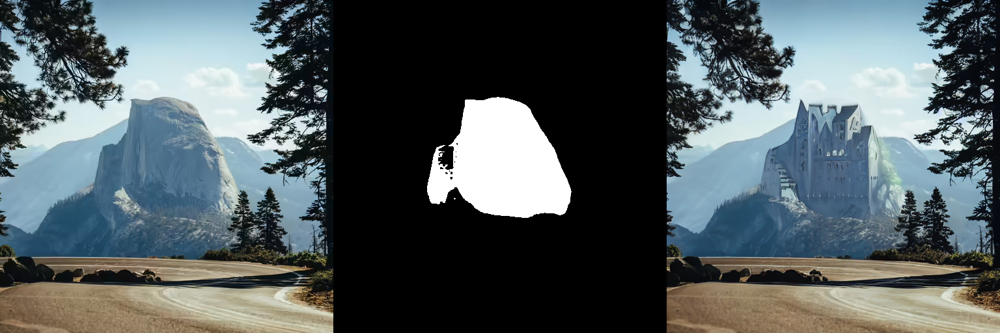

In [21]:
import torch
from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

pipeline = AutoPipelineForInpainting.from_pretrained(
    "runwayml/stable-diffusion-inpainting", torch_dtype=torch.float16, variant="fp16"
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

# load base and mask image
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint_mask.png")

prompt = "concept art digital painting of an elven castle, inspired by lord of the rings, highly detailed, 8k"
image = pipeline(prompt=prompt, image=init_image, mask_image=mask_image, strength=0.6).images[0]
make_image_grid([init_image, mask_image, image], rows=1, cols=3)

#### Guidance scale

guidance_scale affects how aligned the text prompt and generated image are.

* 📈 a high guidance_scale value means the prompt and generated image are closely aligned, so the output is a stricter interpretation of the prompt
* 📉 a low guidance_scale value means the prompt and generated image are more loosely aligned, so the output may be more varied from the prompt

You can use strength and guidance_scale together for more control over how expressive the model is. For example, a combination high strength and guidance_scale values gives the model the most creative freedom.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

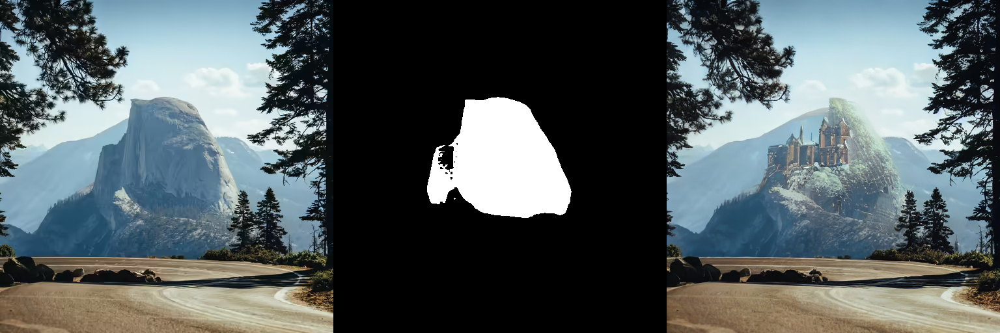

In [22]:
import torch
from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

pipeline = AutoPipelineForInpainting.from_pretrained(
    "runwayml/stable-diffusion-inpainting", torch_dtype=torch.float16, variant="fp16"
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

# load base and mask image
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint_mask.png")

prompt = "concept art digital painting of an elven castle, inspired by lord of the rings, highly detailed, 8k"
image = pipeline(prompt=prompt, image=init_image, mask_image=mask_image, guidance_scale=2.5).images[0]
make_image_grid([init_image, mask_image, image], rows=1, cols=3)

#### Negative prompt

A negative prompt assumes the opposite role of a prompt; it guides the model away from generating certain things in an image. This is useful for quickly improving image quality and preventing the model from generating things you don’t want.

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

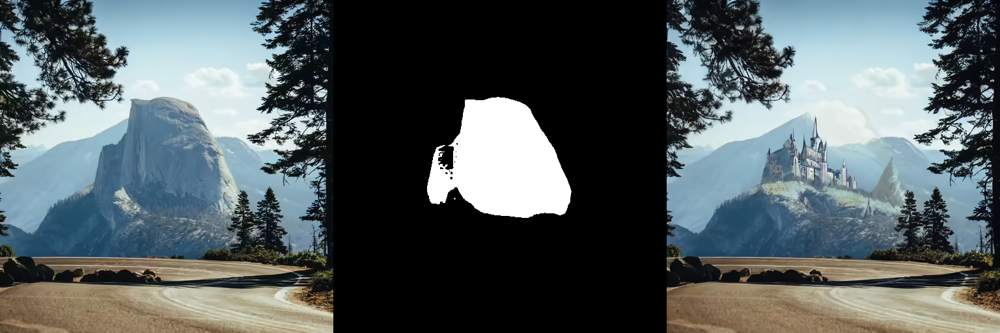

In [23]:
import torch
from diffusers import AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

pipeline = AutoPipelineForInpainting.from_pretrained(
    "runwayml/stable-diffusion-inpainting", torch_dtype=torch.float16, variant="fp16"
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

# load base and mask image
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint_mask.png")

prompt = "concept art digital painting of an elven castle, inspired by lord of the rings, highly detailed, 8k"
negative_prompt = "bad architecture, unstable, poor details, blurry"
image = pipeline(prompt=prompt, negative_prompt=negative_prompt, image=init_image, mask_image=mask_image).images[0]
make_image_grid([init_image, mask_image, image], rows=1, cols=3)

#### Chained inpainting pipelines

AutoPipelineForInpainting can be chained with other 🤗 Diffusers pipelines to edit their outputs. This is often useful for improving the output quality from your other diffusion pipelines, and if you’re using multiple pipelines, it can be more memory-efficient to chain them together to keep the outputs in latent space and reuse the same pipeline components.

#### Text-to-image-inpaint

Chaining a text-to-image and inpainting pipeline allows you to inpaint the generated image, and you don’t have to provide a base image to begin with. This makes it convenient to edit your favorite text-to-image outputs without having to generate an entirely new image.

Start with the text-to-image pipeline to create a castle:

In [24]:
import torch
from diffusers import AutoPipelineForText2Image, AutoPipelineForInpainting
from diffusers.utils import load_image, make_image_grid

pipeline = AutoPipelineForText2Image.from_pretrained(
    "runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16, variant="fp16", use_safetensors=True
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

text2image = pipeline("concept art digital painting of an elven castle, inspired by lord of the rings, highly detailed, 8k").images[0]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

Load the mask image of the output from above:

In [25]:
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint_text-chain-mask.png")

And let's inpaint the masked area with a waterfall:

Loading pipeline components...:   0%|          | 0/3 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

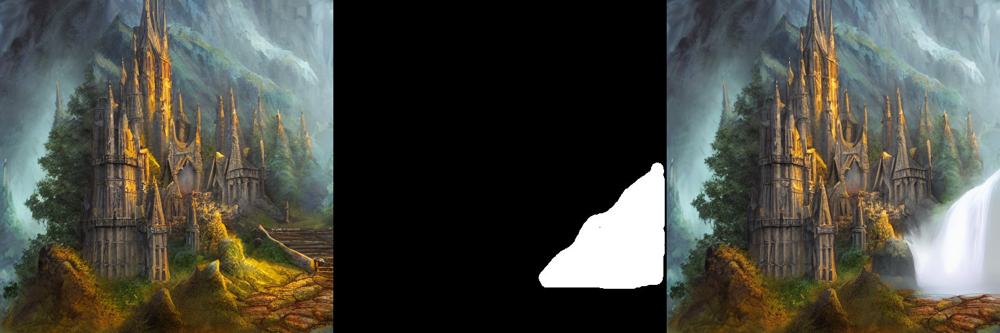

In [26]:
pipeline = AutoPipelineForInpainting.from_pretrained(
    "kandinsky-community/kandinsky-2-2-decoder-inpaint", torch_dtype=torch.float16
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

prompt = "digital painting of a fantasy waterfall, cloudy"
image = pipeline(prompt=prompt, image=text2image, mask_image=mask_image).images[0]
make_image_grid([text2image, mask_image, image], rows=1, cols=3)

#### Inpaint-to-image-to-image

You can also chain an inpainting pipeline before another pipeline like image-to-image or an upscaler to improve the quality.

Begin by inpainting an image:

In [27]:
import torch
from diffusers import AutoPipelineForInpainting, AutoPipelineForImage2Image
from diffusers.utils import load_image, make_image_grid

pipeline = AutoPipelineForInpainting.from_pretrained(
    "runwayml/stable-diffusion-inpainting", torch_dtype=torch.float16, variant="fp16"
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

# load base and mask image
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint_mask.png")

prompt = "concept art digital painting of an elven castle, inspired by lord of the rings, highly detailed, 8k"
image_inpainting = pipeline(prompt=prompt, image=init_image, mask_image=mask_image).images[0]

# resize image to 1024x1024 for SDXL
image_inpainting = image_inpainting.resize((1024, 1024))

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/50 [00:00<?, ?it/s]

Now let’s pass the image to another inpainting pipeline with SDXL’s refiner model to enhance the image details and quality:

In [28]:
pipeline = AutoPipelineForInpainting.from_pretrained(
    "stabilityai/stable-diffusion-xl-refiner-1.0", torch_dtype=torch.float16, variant="fp16"
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

image = pipeline(prompt=prompt, image=image_inpainting, mask_image=mask_image, output_type="latent").images[0]

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

It is important to specify output_type="latent" in the pipeline to keep all the outputs in latent space to avoid an unnecessary decode-encode step. This only works if the chained pipelines are using the same VAE. For example, in the Text-to-image-to-inpaint section, Kandinsky 2.2 uses a different VAE class than the Stable Diffusion model so it won’t work. But if you use Stable Diffusion v1.5 for both pipelines, then you can keep everything in latent space because they both use AutoencoderKL.

Finally, you can pass this image to an image-to-image pipeline to put the finishing touches on it. It is more efficient to use the from_pipe() method to reuse the existing pipeline components, and avoid unnecessarily loading all the pipeline components into memory again.

  0%|          | 0/15 [00:00<?, ?it/s]

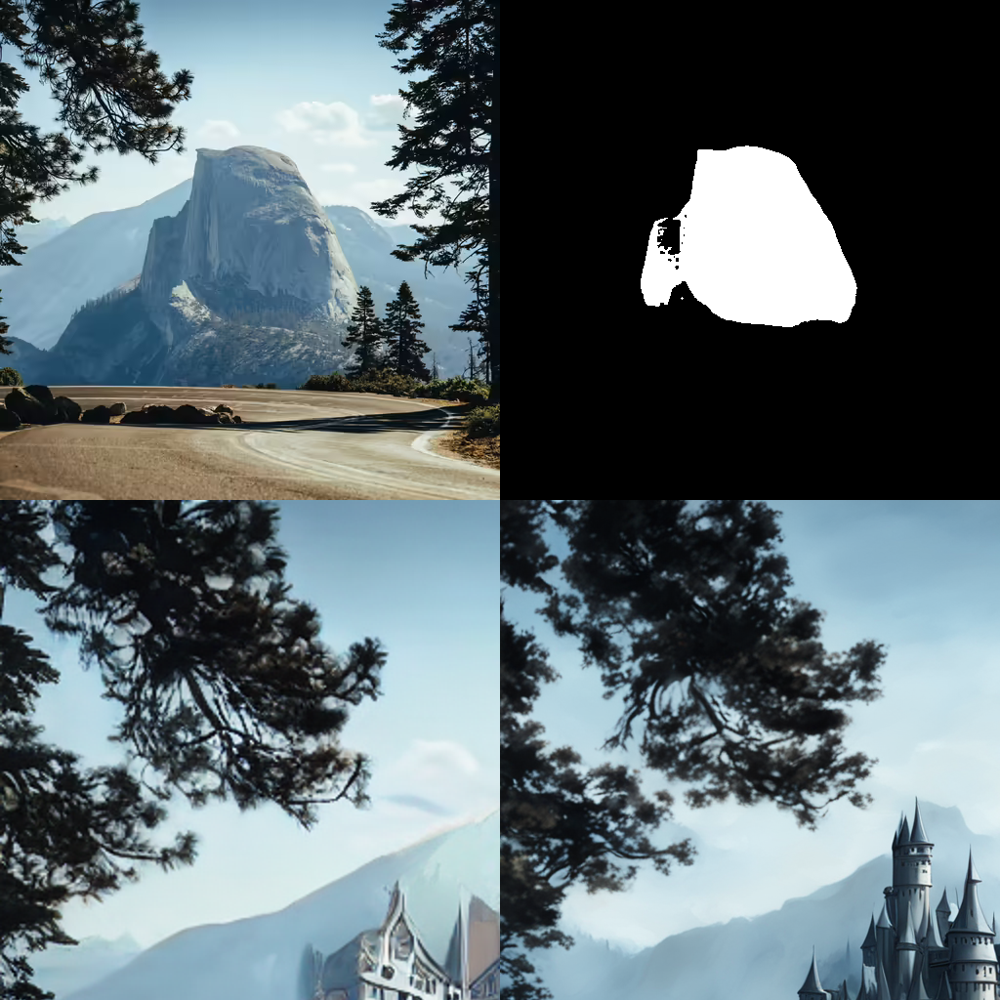

In [29]:
pipeline = AutoPipelineForImage2Image.from_pipe(pipeline)
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

image = pipeline(prompt=prompt, image=image).images[0]
make_image_grid([init_image, mask_image, image_inpainting, image], rows=2, cols=2)

Image-to-image and inpainting are actually very similar tasks. Image-to-image generates a new image that resembles the existing provided image. Inpainting does the same thing, but it only transforms the image area defined by the mask and the rest of the image is unchanged. You can think of inpainting as a more precise tool for making specific changes and image-to-image has a broader scope for making more sweeping changes.

#### Control image generation

Getting an image to look exactly the way you want is challenging because the denoising process is random. While you can control certain aspects of generation by configuring parameters like negative_prompt, there are better and more efficient methods for controlling image generation.

#### Prompt weighting

Prompt weighting provides a quantifiable way to scale the representation of concepts in a prompt. You can use it to increase or decrease the magnitude of the text embedding vector for each concept in the prompt, which subsequently determines how much of each concept is generated. The Compel library offers an intuitive syntax for scaling the prompt weights and generating the embeddings. Learn how to create the embeddings in the Prompt weighting guide.

Once you’ve generated the embeddings, pass them to the prompt_embeds (and negative_prompt_embeds if you’re using a negative prompt) parameter in the AutoPipelineForInpainting. The embeddings replace the prompt parameter:

In [30]:
import torch
from diffusers import AutoPipelineForInpainting
from diffusers.utils import make_image_grid

pipeline = AutoPipelineForInpainting.from_pretrained(
    "runwayml/stable-diffusion-inpainting", torch_dtype=torch.float16,
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

# So what the hell do we get prompt_enbeds and negative_prompt_embeds from?

image = pipeline(prompt_embeds=prompt_embeds, # generated from Compel
    negative_prompt_embeds=negative_prompt_embeds, # generated from Compel
    image=init_image,
    mask_image=mask_image
).images[0]
make_image_grid([init_image, mask_image, image], rows=1, cols=3)

text_encoder/model.safetensors not found


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


NameError: name 'prompt_embeds' is not defined

#### ControlNet

ControlNet models are used with other diffusion models like Stable Diffusion, and they provide an even more flexible and accurate way to control how an image is generated. A ControlNet accepts an additional conditioning image input that guides the diffusion model to preserve the features in it.

For example, let’s condition an image with a ControlNet pretrained on inpaint images:

In [31]:
import torch
import numpy as np
from diffusers import ControlNetModel, StableDiffusionControlNetInpaintPipeline
from diffusers.utils import load_image, make_image_grid

# load ControlNet
controlnet = ControlNetModel.from_pretrained("lllyasviel/control_v11p_sd15_inpaint", torch_dtype=torch.float16, variant="fp16")

# pass ControlNet to the pipeline
pipeline = StableDiffusionControlNetInpaintPipeline.from_pretrained(
    "runwayml/stable-diffusion-inpainting", controlnet=controlnet, torch_dtype=torch.float16, variant="fp16"
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

# load base and mask image
init_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint.png")
mask_image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/inpaint_mask.png")

# prepare control image
def make_inpaint_condition(init_image, mask_image):
    init_image = np.array(init_image.convert("RGB")).astype(np.float32) / 255.0
    mask_image = np.array(mask_image.convert("L")).astype(np.float32) / 255.0

    assert init_image.shape[0:1] == mask_image.shape[0:1], "image and image_mask must have the same image size"
    init_image[mask_image > 0.5] = -1.0  # set as masked pixel
    init_image = np.expand_dims(init_image, 0).transpose(0, 3, 1, 2)
    init_image = torch.from_numpy(init_image)
    return init_image

control_image = make_inpaint_condition(init_image, mask_image)

# 10m 24.9s

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


In [32]:
!ls /root/.cache/huggingface/hub

models--CompVis--stable-diffusion-v1-4
models--TheBloke--CodeLlama-34B-Instruct-GPTQ
models--TheBloke--Llama-2-13b-Chat-GPTQ
models--anton-l--ddpm-butterflies-128
models--diffusers--stable-diffusion-xl-1.0-inpainting-0.1
models--google--ddpm-cat-256
models--google--ddpm-celebahq-256
models--google--ddpm-church-256
models--kandinsky-community--kandinsky-2-2-decoder
models--kandinsky-community--kandinsky-2-2-decoder-inpaint
models--kandinsky-community--kandinsky-2-2-prior
models--kohbanye--pixel-art-style
models--lllyasviel--control_v11p_sd15_inpaint
models--lllyasviel--control_v11p_sd15_openpose
models--microsoft--Orca-2-13b
models--microsoft--phi-2
models--mistralai--Mistral-7B-Instruct-v0.2
models--nitrosocke--Ghibli-Diffusion
models--nitrosocke--elden-ring-diffusion
models--ogkalu--Comic-Diffusion
models--runwayml--stable-diffusion-inpainting
models--runwayml--stable-diffusion-v1-5
models--stabilityai--sd-vae-ft-mse
models--stabilityai--sd-x2-latent-upscaler
models--stabilityai--stab

In [33]:
# docker cp c8324b70601d:///root/.cache/huggingface/hub/models--lllyasviel--control_v11p_sd15_inpaint /home/rob/Data3/huggingface/transformers
# Successfully copied 723MB to /home/rob/Data3/huggingface/transformers

Now generate an image from the base, mask and control images. You’ll notice features of the base image are strongly preserved in the generated image.

  0%|          | 0/50 [00:00<?, ?it/s]

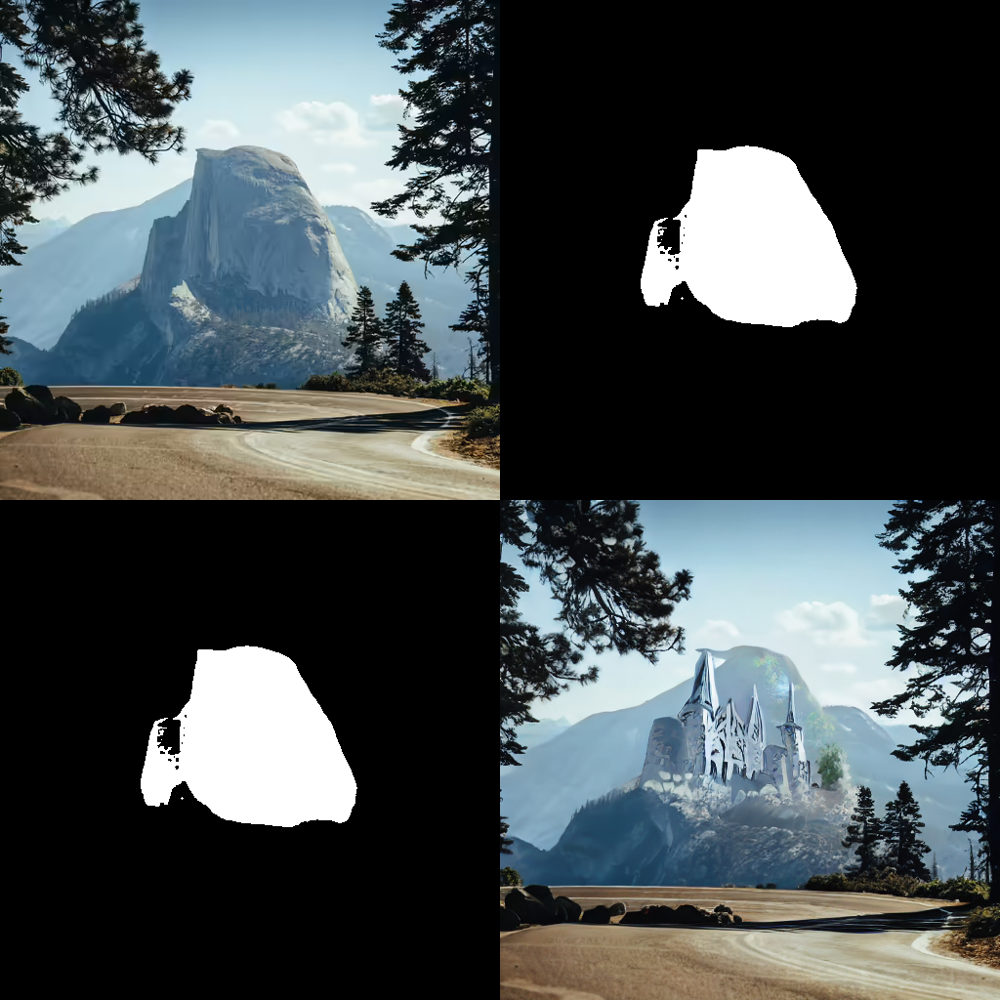

In [34]:
import PIL
import numpy as np

prompt = "concept art digital painting of an elven castle, inspired by lord of the rings, highly detailed, 8k"
image = pipeline(prompt=prompt, image=init_image, mask_image=mask_image, control_image=control_image).images[0]
make_image_grid([init_image, mask_image, PIL.Image.fromarray(np.uint8(control_image[0][0])).convert('RGB'), image], rows=2, cols=2)

You can take this a step further and chain it with an image-to-image pipeline to apply a new style:

text_encoder/model.safetensors not found


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


  0%|          | 0/40 [00:00<?, ?it/s]

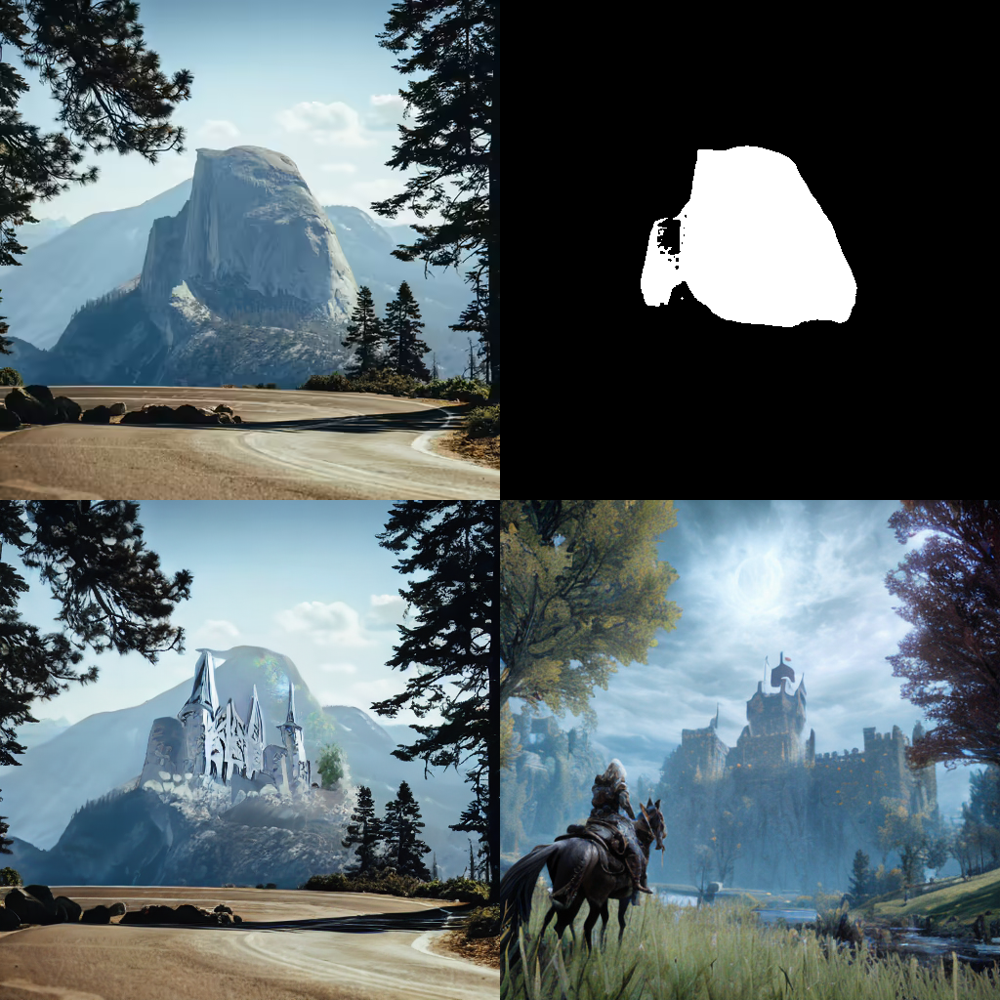

In [35]:
from diffusers import AutoPipelineForImage2Image

pipeline = AutoPipelineForImage2Image.from_pretrained(
    "nitrosocke/elden-ring-diffusion", torch_dtype=torch.float16,
)
pipeline.enable_model_cpu_offload()
# remove following line if xFormers is not installed or you have PyTorch 2.0 or higher installed
# pipeline.enable_xformers_memory_efficient_attention()

prompt = "elden ring style castle" # include the token "elden ring style" in the prompt
negative_prompt = "bad architecture, deformed, disfigured, poor details"

image_elden_ring = pipeline(prompt, negative_prompt=negative_prompt, image=image).images[0]
make_image_grid([init_image, mask_image, image, image_elden_ring], rows=2, cols=2)

# 76m 52.0s

In [36]:
!ls /root/.cache/huggingface/hub

models--CompVis--stable-diffusion-v1-4
models--TheBloke--CodeLlama-34B-Instruct-GPTQ
models--TheBloke--Llama-2-13b-Chat-GPTQ
models--anton-l--ddpm-butterflies-128
models--diffusers--stable-diffusion-xl-1.0-inpainting-0.1
models--google--ddpm-cat-256
models--google--ddpm-celebahq-256
models--google--ddpm-church-256
models--kandinsky-community--kandinsky-2-2-decoder
models--kandinsky-community--kandinsky-2-2-decoder-inpaint
models--kandinsky-community--kandinsky-2-2-prior
models--kohbanye--pixel-art-style
models--lllyasviel--control_v11p_sd15_inpaint
models--lllyasviel--control_v11p_sd15_openpose
models--microsoft--Orca-2-13b
models--microsoft--phi-2
models--mistralai--Mistral-7B-Instruct-v0.2
models--nitrosocke--Ghibli-Diffusion
models--nitrosocke--elden-ring-diffusion
models--ogkalu--Comic-Diffusion
models--runwayml--stable-diffusion-inpainting
models--runwayml--stable-diffusion-v1-5
models--stabilityai--sd-vae-ft-mse
models--stabilityai--sd-x2-latent-upscaler
models--stabilityai--stab

In [37]:
# docker cp c8324b70601d:///root/.cache/huggingface/hub/models--nitrosocke--elden-ring-diffusion /home/rob/Data3/huggingface/transformers
# Successfully copied 5.48GB to /home/rob/Data3/huggingface/transformers